# ASSIGNMENT 2

**NOME:** Christian

**COGNOME:** Uccheddu

**MATRICOLA:** 800428

> This assignment is based on the code of Prof. Samuel Albani left during the lessons.

First the necessary libraries are imported in which the relative versions are also printed so that everything is reproducible.

In [30]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
from scipy import stats
import scipy
import seaborn as sns
import seaborn
from pylab import *

import datetime as dtm
from datetime import datetime

import matplotlib.pyplot as plt
import cartopy.crs as ccrs

import matplotlib
import cartopy

pd.options.mode.chained_assignment = None

print("Pandas version:",pd.__version__)
print("Numpy version:",np.__version__)
print("Cartopy version:",cartopy.__version__)
print("Geoandas version:",gpd.__version__)
print("Matplotlib version:",matplotlib.__version__)
print("Scipy version:",scipy.__version__)
print("Seaborn version:",sns.__version__)

Pandas version: 1.2.3
Numpy version: 1.19.2
Cartopy version: 0.18.0
Geoandas version: 0.8.1
Matplotlib version: 3.3.4
Scipy version: 1.6.1
Seaborn version: 0.11.1


In [2]:
flist = [os.path.join(path, name) for path, subdirs, files in os.walk("./CRUTEM.4.6.0.0.station_files/") for name in files]
for i in range(0,5):
    print(flist[i])


flist=flist[2:]

print ('\n',flist[0:5])
nst=len(flist)
print ("\n > Number of stations = ",nst)

./CRUTEM.4.6.0.0.station_files/.DS_Store
./CRUTEM.4.6.0.0.station_files/Index
./CRUTEM.4.6.0.0.station_files/61/616120
./CRUTEM.4.6.0.0.station_files/61/612913
./CRUTEM.4.6.0.0.station_files/61/612770

 ['./CRUTEM.4.6.0.0.station_files/61/616120', './CRUTEM.4.6.0.0.station_files/61/612913', './CRUTEM.4.6.0.0.station_files/61/612770', './CRUTEM.4.6.0.0.station_files/61/614010', './CRUTEM.4.6.0.0.station_files/61/618470']

 > Number of stations =  10296


First we take care of importing the data. Since these have a specific organization we must take care of doing it correctly. In fact, the first lines contain the metadata relating to the temperature measurement stations that we will save in a separate dataframe so that they can be used easily. Station IDs will be used as primar key for both dataframes

In [3]:
metadata0 = pd.DataFrame(columns=['ID','stname','country','elev','lat','lon'])

First, I will define a common time axis, along which all time series will be aligned. This will be the index of gdf.

In [4]:
taxis = pd.date_range('1850-01', '2019-01', freq='M')
nmonths=len(taxis)
nyears=nmonths/12

data0 = pd.DataFrame({'time': taxis})
data0 = data0.set_index(['time'])

We will use the years 1961 to 1990 as the reference period so that we can eliminate those stations that do not have enough data for that reference period.

In [5]:
yref0 = 1961
yref1 = 1990

Based on the file structures we use the following function to import the files correctly by extracting all the information we need. In the following function we also take into account stations that do not have enough data to eliminate them.

In [6]:
# Dataset acquisition

nst_tmp = nst   #nst #200

#- set counters for diagnostics 
nodatacount=0  
tooshortcount=0 
outsidecount=0

from tqdm import tqdm
for si in tqdm(range(0,nst_tmp)):
    
  #- open file 
  
    filein=flist[si]
  
    #- Scan text file to find starting line of data matrix &
    #- check for the actual presence of data
    try:
        with open(filein) as f: data = f.readlines()
        skipi = data.index("Obs:\n")+1
        if (len(data)-skipi < 2):
            nodatacount+=1    
            continue

        #- Find out how many years are in the time series for this station &
        #-   apply some filters on the time series lenght and/or timing as a condition to include the station in the dataset
        #- I could use the metadata (Start year, End year) or 
        #-   get this piece of info from the actual data >>> I chose the second option   

        #- I read the first column of the data table, which constains the list of years
        yr = np.genfromtxt(filein, skip_header=skipi, delimiter=None, usecols=0, dtype='i4')
        nyr = len(yr)

        # this filters out data series that are too short (e.g. less than 30 years)  
        if (nyr < 30):
            tooshortcount+=1 
            continue  

        # do not retain series not covering at least in part the reference period   
        #if (yr[0]>yref1 or yr[-1]<yref0):
        #  outsidecount+=1 
        #  continue       

        # OR  

        # retain only the stations for which the calculation of the average annual cycle for the reference period 
        # yields non-NAN values for each month, i.e. the normals have no missing value

        norm_line = [line for line in data if "Normals=" in line]
        norm = str(norm_line).split("=",1)[1]
        norm  = norm[:-4].strip() 
        if (norm.find("-99.0") > -1):   #str.find returns the position of the given substring, -1 if not found
            outsidecount+=1 
            continue   

        #- If the station is retained, then gather data & metadata 

        # FROM THE TEMPLATE ...  
        # Name= LONDON/GATWICK
        # Country= UK
        # Lat=   51.2
        # Long=    0.2
        # Height= 59

        # Get local values for * METADATA * of interest

        stname_line = [line for line in data if "Name=" in line]
        stname = str(stname_line).split("=",1)[1]
        stname  = stname[:-4].strip()    

        country_line = [line for line in data if "Country=" in line]
        country = str(country_line).split("=",1)[1]
        country  = country[:-4].strip()  # this removes leading & trailing strings, incl. "new line" [\n] at the end 

        elev_line = [line for line in data if "Height=" in line]
        elev = str(elev_line).split("=",1)[1] 
        elev = float(elev[:-4].strip())

        lat_line = [line for line in data if "Lat=" in line]
        lat = str(lat_line).split("=",1)[1] 
        lat = float(lat[:-4].strip())

        lon_line = [line for line in data if "Long=" in line]
        lon = str(lon_line).split("=",1)[1] 
        lon = float(lon[:-4].strip())      

        # Append local values to metadata df

        metadata0 = metadata0.append({
         "ID": filein[-6:],
         "stname": stname,
         "country": country,
         "elev": elev,
         "lat":  lat,      
         "lon":  lon,
         }, ignore_index=True)


        #- Finally, read and arrange * DATA * (temperature time series)

        # FROM THE TEMPLATE ...  
        # ...
        # Obs:
        # 1961   3.9   7.1   7.5  10.3  11.0  14.7  15.9  16.1  15.7  10.9   6.4   2.7   501   501   501   501   501   501   501   501   501   501   501   501 
        # 1962   4.1   4.5   2.5   7.6   9.8  13.0  15.1  14.7  12.6  10.5   5.9   1.7   501   501   501   501   501   501   501   501   501   501   501   501 

        # We need to go from 2D to 1D oragnization of temperature data &
        #  associate each temperature to a datetime index
        # This way we can coherently build a 2D df (time, station), 
        #  on which we could later drop stations or slice/gropuby by time  
        # >>> I will build a local df, then append it to the general df  

        #- build local time axis
        # yr: the first column of the data table, which constains the list of years (defined above)

        ti0 = datetime.strptime(str(yr[0]), "%Y")
        ti1 = datetime.strptime(str(yr[nyr-1]+1), "%Y")
        stime = pd.date_range(ti0, ti1, freq='M')     
        if ((yr[nyr-1]-yr[0]+1) != len(yr)):  # check if data of any year are missing within the first and last year
            print('WARNING: station {} has missing years !'.format(metadata0.ID[si]))

        #- read in the 2D table (left side with temperature data) as a numpy array, which I can later reshape into 1D

        loc_data_2d = np.genfromtxt(filein, skip_header=skipi, filling_values='-99.0', delimiter=None, dtype='float')[:,1:13]  #[rows,cols]
        loc_data_1d = loc_data_2d.flatten()

        #- check that the order of element rearrangement is correct
        #print(np.shape(loc_data_2d),nyr)
        #print('@@',loc_data_2d[:2,:])
        #print(loc_data_1d[:24],'\n')

        #- build local station dataframe, using the station ID as column name

        xdf = pd.DataFrame({'time': stime, filein[-6:]: np.asarray(loc_data_1d)})
        xdf = xdf.set_index('time')

        #- merge into global dataframe, using the station ID as column name

        data0 = pd.merge(data0, xdf, on='time', how='left')
    except:
        print(f)
        continue

 61%|██████    | 6302/10296 [03:18<01:06, 59.80it/s] 

<_io.TextIOWrapper name='./CRUTEM.4.6.0.0.station_files/96/961690' mode='r' encoding='UTF-8'>


100%|██████████| 10296/10296 [06:10<00:00, 27.80it/s]


After the code crashed it was decided to insert the try / except function to see which file the problem was in. We then noticed that the problem file was number **961690**. Opening it separately, we realized that this file had no observations and this is why an error was raised. Through the use of the except function it was therefore decided not to consider this file. Now let's print this information.

In [7]:
print(nodatacount,' stations with no data (not acquired)')
print(tooshortcount,' stations with too little data (not acquired)')
print(outsidecount,' stations with not enough data for the ref. period (not acquired)')
print("{} [{}] valid stations acquired".format(nst_tmp-nodatacount-tooshortcount-outsidecount,len(metadata0.ID)))

13  stations with no data (not acquired)
2055  stations with too little data (not acquired)
770  stations with not enough data for the ref. period (not acquired)
7458 [7457] valid stations acquired


In [8]:
print(metadata0)

          ID                stname     country   elev   lat    lon
0     616120                 PODOR     SENEGAL    6.0  16.6   14.9
1     612913              KOULOUBA        MALI  485.0  12.7    8.0
2     612770                   SAN        MALI  283.0  13.3    4.9
3     614010          BIR MOGHREIN  MAURITANIA  364.0  25.2   11.6
4     618470               MACENTA      GUINEA  544.0   8.5    9.5
...      ...                   ...         ...    ...   ...    ...
7452  251230              CHERSKIJ      RUSSIA   28.0  68.8 -161.3
7453  253560  EN` MUVEEM----------      RUSSIA   77.0  66.3 -173.3
7454  253990  MYS UELEN-----------      RUSSIA    3.0  66.1  169.8
7455  256210  KEDON---------------      RUSSIA  683.0  64.0 -158.9
7456  252820  MYS VANKAREM--------      RUSSIA    5.0  67.8  175.8

[7457 rows x 6 columns]


In [9]:
print(data0.iloc[1500:1505,0:10])

            616120  612913  612770  614010  618470  614420  618810  619900  \
time                                                                         
1975-01-31    23.2    23.1    22.3    16.3    21.6    22.0    26.0    26.0   
1975-02-28    25.0    26.1    25.2    18.5    25.1    21.9    27.1    26.2   
1975-03-31    26.5    28.6    29.6   -99.0    26.1   -99.0    27.7    25.6   
1975-04-30    28.3   -99.0    32.4    19.7    25.3    22.1    27.1    25.2   
1975-05-31    31.4   -99.0    31.8   -99.0    25.1    23.8    26.7    23.1   

            617660  612912  
time                        
1975-01-31    25.4    23.5  
1975-02-28    26.6    26.3  
1975-03-31    26.6    29.4  
1975-04-30    28.2    31.6  
1975-05-31    26.9    31.3  


Now let's make some pre-processing operations. In particular, we noticed that the incorrect values have been replaced with the value -99. We then use the numpy NaN object to substitute this value so that we can treat it later with more precision. In addition we fix the values of longitudes.

In [10]:
data0[data0 == -99.0] = np.nan
metadata0 = metadata0.set_index(['ID'])
metadata0.lon = -metadata0.lon

We graph the stations as red dots on the map. In the left plot we show the position on the map of the station while in the right plot we show the time series of the relative station.

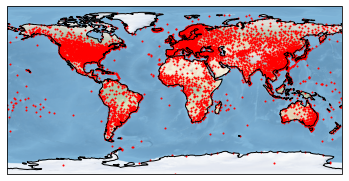

In [11]:
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.stock_img()
ax.scatter([metadata0.lon],[metadata0.lat],color='r',marker='o',s=1.0)
plt.show()

Plot time series of 6 randomly chosen stations. In the left plot we show the position on the map of the station while in the right plot we show the time series of the relative station.

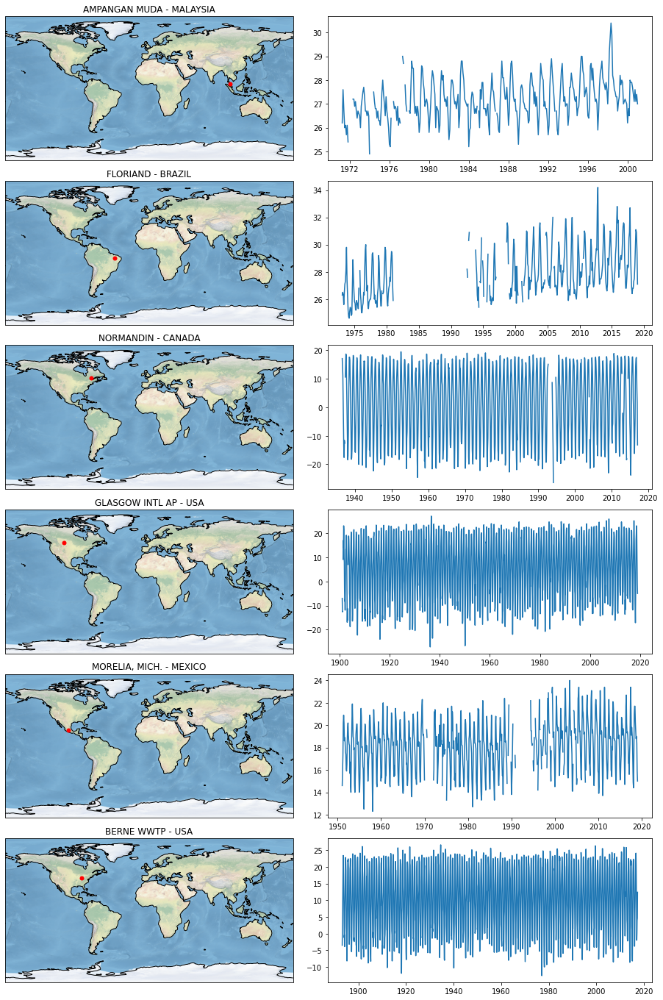

In [12]:
#- Set multipanel plot
fig = plt.figure(figsize=(13,19))

no = 6   # number of randomn stations to pick

subplots = (no,2)
n_panels = subplots[0] * subplots[1]

proj = ccrs.PlateCarree()

#- Select sites
rssite = np.random.randint(len(data0.columns), size=no)
ssite = metadata0.index[rssite]

for fi, f in enumerate(ssite):

    #- locate on map
    ax = fig.add_subplot(subplots[0], subplots[1], (fi*2)+1, projection=proj)
    ax.set_title(' - '.join([metadata0.stname[ssite[fi]],metadata0.country[ssite[fi]]]))
    ax.stock_img()
    ax.coastlines()
    plt.plot(metadata0.lon[ssite[fi]], metadata0.lat[ssite[fi]],
         color='red', marker='o', markersize=5,
         transform=ccrs.Geodetic())         
 
    #- time series
    tser = fig.add_subplot(subplots[0], subplots[1], (fi+1)*2)
    #data0[ssite[fi]].plot()  
    plt.plot(data0[ssite[fi]])

fig.tight_layout()
plt.show()

In this step we transform all TEMPERATURE time series to TEMPERATURE ANOMALY time series, with respect to a reference period. In particular we used:

$\text{ANOMALY}(y,m) = \text{DATA}(y,m) - \text{AVERAGE}[\text{ref.period}](m)$ , for each month (m=1..12), for each year (y=1850..2019)

AVERAGE\[ref. period\](m) is in fact the "Normals", that we could have stored while acquiring the data & metadata, or alternatively we could recalculate here.  First, let's identify the position along the time index that corresponds to the begining/end of the reference period which is in this case the period 1961-01-31 / 1990-12-31.

In [14]:
x1=data0.index.get_loc('1961-01-31')
x2=data0.index.get_loc('1990-12-31')

# Then calculate the "Normals"

data_normals = data0[x1:x2].groupby(data0[x1:x2].index.month).mean()
print(data_normals)

         616120     612913     612770     614010     618470     614420  \
time                                                                     
1     22.979310  25.065217  23.843333  16.984615  22.718519  21.124138   
2     25.748276  27.926087  26.900000  18.813043  24.477778  22.738462   
3     27.810345  30.326087  30.096667  21.162500  25.544444  24.131034   
4     29.778571  31.331818  32.703333  21.807692  25.574074  24.337037   
5     31.925000  30.459091  33.113333  24.057692  25.240741  25.381481   
6     32.250000  28.004545  30.633333  27.025000  24.440741  26.792857   
7     30.810714  25.636364  28.123333  32.137500  23.696429  26.903704   
8     30.090000  24.918182  27.033333  31.518519  23.651852  28.138462   
9     30.507143  25.622727  27.503333  30.000000  24.042857  29.244444   
10    30.914286  27.178261  29.170000  25.479167  24.310714  28.526923   
11    27.772414  27.365217  27.526667  20.743478  23.960714  25.270833   
12    23.792593  25.313043  24.275862 

Finally, let's subtract normals from the the original time series, to get the time series of the temperature anomalies for each station 
We wil also make a copy of data0 (data\_anom) to store the anomalies.

In [15]:
data_anom = data0.copy()

Then loop through all the years (January) in the time axis, and substract the Normals from each chunk of 12 months

In [16]:
y0 = 0
for yi in range(0,int(nyears)):
    data_anom.iloc[y0:y0+12,:] = data0.iloc[y0:y0+12,:]-np.array(data_normals.iloc[:,:])
    y0+=12

Now let's plot again the time series from a few randomly chosen stations

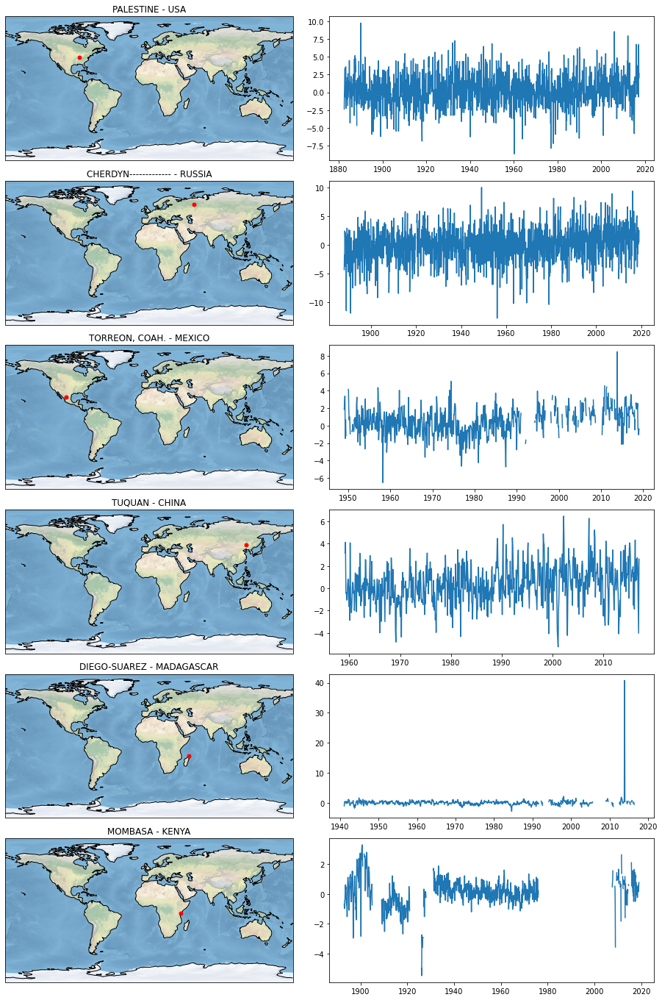

In [17]:
#- Set multipanel plot
fig = plt.figure(figsize=(13,19))

no = 6   # number of randomn stations to pick

subplots = (no,2)
n_panels = subplots[0] * subplots[1]

proj = ccrs.PlateCarree()

#- Select sites
rssite = np.random.randint(len(data0.columns), size=no)
ssite = metadata0.index[rssite]

for fi, f in enumerate(ssite):

    #- locate on map
    ax = fig.add_subplot(subplots[0], subplots[1], (fi*2)+1, projection=proj)
    ax.set_title(' - '.join([metadata0.stname[ssite[fi]],metadata0.country[ssite[fi]]]))
    ax.stock_img()
    ax.coastlines()
    plt.plot(metadata0.lon[ssite[fi]], metadata0.lat[ssite[fi]],
         color='red', marker='o', markersize=5,
         transform=ccrs.Geodetic())         
 
    #- time series
    tser = fig.add_subplot(subplots[0], subplots[1], (fi+1)*2)
    #data0[ssite[fi]].plot()  
    plt.plot(data_anom[ssite[fi]])

fig.tight_layout()
plt.show()

Let's now proceed with the spatial aggregation operations in order to have manageable data to calculate anomaly temperatures. All data are aggregated (averaged) in a regular lat/lon grid covering the Earth surface; in this way, we are "homogenizing" the spatial distribution of our dataset. One way would be to build a grid (e.g. a couple of 1D lists/arrays or one 2D array) containing the lats/lons margins of grid cells. Then slicing based on lats and lons ranges can be used to calculate the average time series from the grid cell. Now we aggregate the gridded data from monthly to annual time step. 
>In this case we are considering all data irrispective of the fact that a given year has NaN for ceratin values

Now let's proceed creating the grid and the cell margins.

In [18]:
resol = 20 #5  # degrees (E and N)
nlon = np.int(360/resol)
nlat = np.int(180/resol)

grlons = np.empty([nlon+1],dtype='float') 
grlats = np.empty([nlat+1],dtype='float') 
grlons[0] = -180.
grlats[0] = -90.
for i in range(1,nlon+1):
    grlons[i]=grlons[i-1]+resol
for i in range(1,nlat+1):
    grlats[i]=grlats[i-1]+resol

Let's choose a 3D numpy array to store the time series.

In [19]:
data_mo = np.empty([nmonths,nlat,nlon],dtype=float)
data_mo[:,:,:] = np.nan

data_yr = np.empty([int(nyears),nlat,nlon],dtype=float)
data_yr[:,:,:] = np.nan

Now let's iterate over grid cells and: 
- get the average time series of all stations in grid cell at monthy resolution
- integrate to annual resolution  

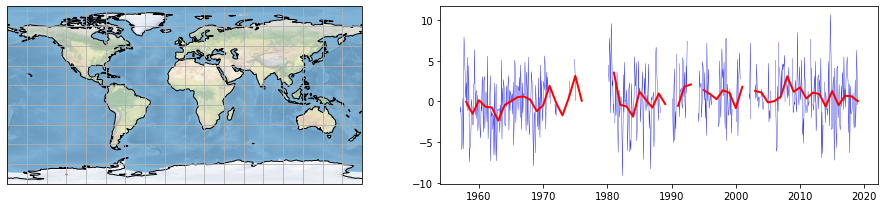

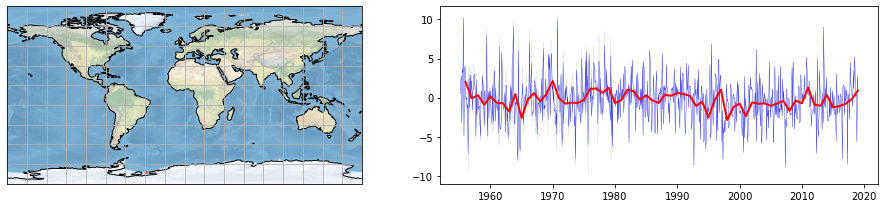

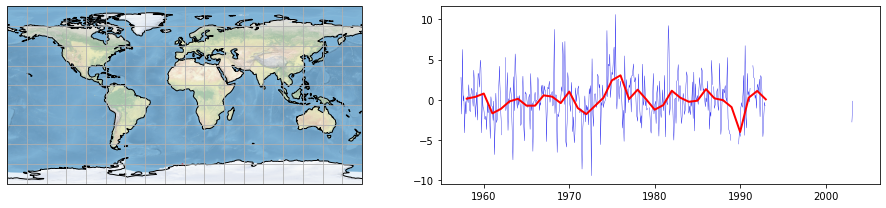

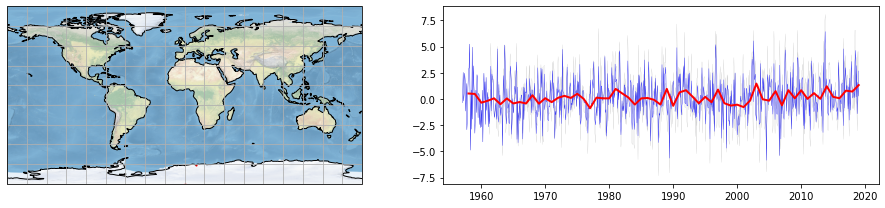

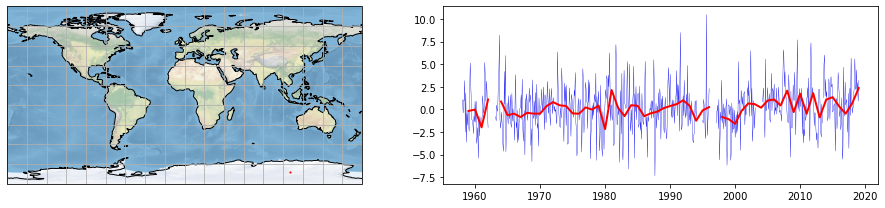

...

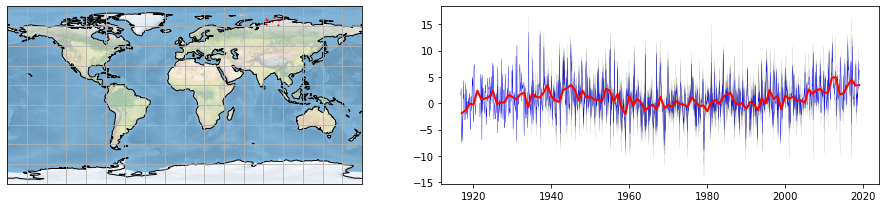

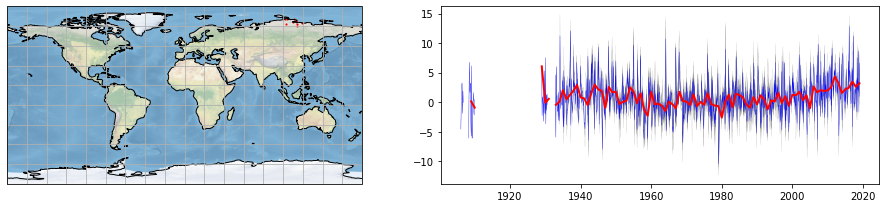

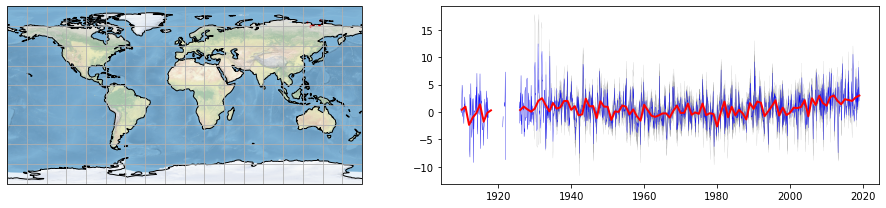

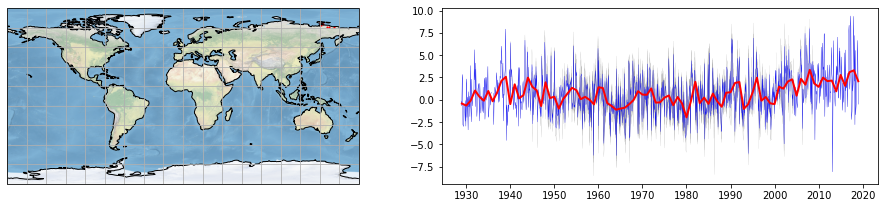

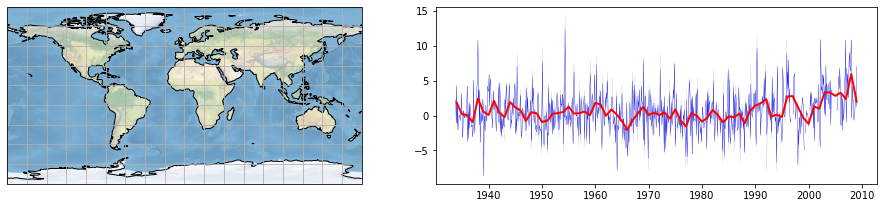

In [20]:
for j in range(0,nlat):
    for i in range(0,nlon):

        dummy = metadata0[metadata0.lon >= grlons[i]]
        dummy = dummy[dummy.lon < grlons[i+1]]
        dummy = dummy[dummy.lat >= grlats[j]]
        dummy = dummy[dummy.lat < grlats[j+1]]

        #print('*',grlons[i],grlons[i+1],grlats[j],grlats[j+1])
        #print(dummy.index)

        if (len(dummy.index) > 0):

            # calculation

            data_mo[:,j,i] = np.array(data_anom[dummy.index].mean(axis=1)).flatten()

            data_yr[:,j,i] = np.array(data_anom[dummy.index].mean(axis=1).resample("Y").mean()).flatten()

          # display to check things  

            fig = plt.figure(figsize=(13,3))  
            subplots = (1,2)
            n_panels = subplots[0] * subplots[1]

            #- locate on map
            ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.PlateCarree())
            ax.stock_img()
            ax.coastlines()
            ax.gridlines(xlocs=range(-180,181,resol), ylocs=range(-90,91,resol))
            ax.scatter([dummy.lon],[dummy.lat],color='r',marker='o',s=1.2)

            #- time series
            tser = fig.add_subplot(subplots[0], subplots[1], 2)
            plt.plot(taxis,data_anom[dummy.index],color='grey',linewidth=0.1)
            plt.plot(taxis,data_mo[:,j,i],color='blue',linewidth=0.3)
            plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_yr[:,j,i],color='red',linewidth=2)  

            fig.tight_layout()  
            plt.show()   

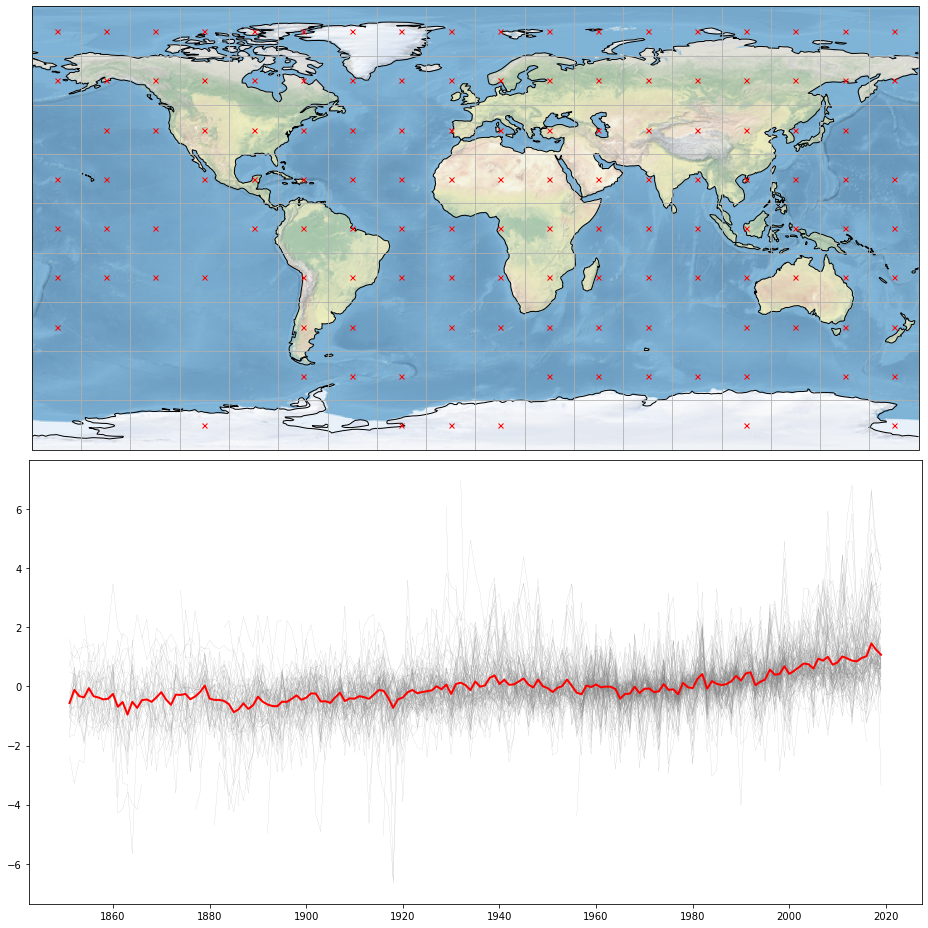

In [21]:
# Prepare to display to check things  

fig = plt.figure(figsize=(13,13))  
subplots = (2,1)

ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.PlateCarree())
ax.stock_img()
ax.coastlines()
ax.gridlines(xlocs=range(-180,181,resol), ylocs=range(-90,91,resol))

tser = fig.add_subplot(subplots[0], subplots[1], 2)

# Initialize data structure to host global average temperature anomaly time series

data_glob = np.empty([int(nyears)],dtype=float)
data_glob[:] = np.nan

# loop over all grid cells

for j in range(0,nlat):
    for i in range(0,nlon):
    
    # Check if current grid cell has an associated time series
    
        if not(np.isnan(data_yr[:,j,i]).all()):
     
      #  place a marker on the map, and plot individual grid cell time series 

            ax.plot( grlons[i:i+2].sum()/2, grlats[j:j+2].sum()/2,
            color='red', marker='x', markersize=5,transform=ccrs.PlateCarree())     
            plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_yr[:,j,i],color='gray',linewidth=0.1) 

# calculate the global average at each time step      
        
for t in range(0,int(nyears)):  

    local = data_yr[t,:,:]
    valid = np.isnan(data_yr[t,:,:])
    data_glob[t] = np.nanmean(local[~valid])

# plot the global average curve  
    
plt.plot(pd.date_range('1850-01', '2019-01', freq='Y'),data_glob[:],color='red',linewidth=2) 

fig.tight_layout()  
plt.show() 

**Now let's compute the average anomaly time series.**

In [22]:
gmta = pd.DataFrame({'time': pd.date_range('1850-01', '2019-01', freq='Y')})
gmta['gmta'] = data_glob[:]
gmta = gmta.set_index(['time'])

## 1) What is the difference in the average the global mean temperature anomaly for the last 30 years of the record, compared to that of the first three decades of the twentieth century ? 

The first thing we do is divide the two time series. The first historical series includes the data between 1900 and 1930 while the second series includes the data between 1988 and 2018. Then we will see the difference between the averages in the two periods.

In [23]:
gmta_reset = gmta.reset_index()
gmta_last_3_decades = gmta_reset.loc[gmta_reset['time'] >= '1988-12-31']
gmta_first_3_decades = gmta_reset.loc[(gmta_reset['time'] >= '1900-12-31') & (gmta_reset['time'] <= '1930-12-31')]

We print on the screen both the average value of the anomalies in the two historical series. Subsequently, the difference between these two averages is also printed.

In [24]:
diff = gmta_last_3_decades['gmta'].mean() - gmta_first_3_decades['gmta'].mean()

print("The mean of the global mean temperature anomaly for the period 1900-1930 is {:.2}°\nThe mean of the global mean temperature anomaly for the period 1988-2018 is {:.2}°\nThe difference between them is {:.2}°".format(gmta_first_3_decades['gmta'].mean(), 
                                          gmta_last_3_decades['gmta'].mean(), 
                                          diff))

The mean of the global mean temperature anomaly for the period 1900-1930 is -0.28°
The mean of the global mean temperature anomaly for the period 1988-2018 is 0.69°
The difference between them is 0.98°


## 2) Is this difference statistically significant ?

To see if the differences between the means of the two distributions are significant I use a Student's T test on the two time series. The null hypothesis of this test is that the means of the two distributions are statistically equivalent. *If the p-value is less than the reference value 0.05 (therefore with a confidence interval around the 95% average) then the null hypothesis is rejected and the means are statistically different.*

In [25]:
t, p = stats.ttest_ind(gmta_last_3_decades['gmta'], gmta_first_3_decades['gmta'], equal_var = False)

alpha = 5e-2

if p < alpha:
    print("Since the p-value is {:.3g} < {} the Null Hypothesis is rejected: the temperature are statistically different".format(p, alpha))
else:
    print("Since the p-value is {:.3g} > {} the Null Hypothesis can't be rejected: the temperature can't be considered statistically different".format(p, alpha))

Since the p-value is 1.06e-18 < 0.05 the Null Hypothesis is rejected: the temperature are statistically different


We see in the following graph the distributions of the anomalies. Through this graph, also highlighting the average value, we can see how the distributions are already different by eye and therefore it is in line with the value of the T statistic.

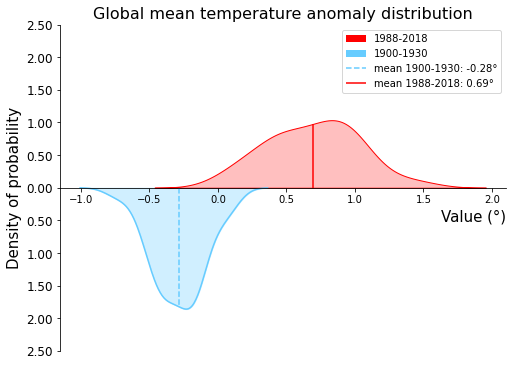

In [26]:
colonna = 'gmta'

fig, ax = plt.subplots(figsize=(8, 6))

sns.kdeplot(gmta_first_3_decades[colonna], color='#66ccff', ax=ax, label = "1900-1930")


x = ax.lines[-1].get_xdata()
y = ax.lines[-1].get_ydata()

for p in ax.patches:  
    p.set_height(-p.get_height())
for l in ax.lines:  
    l.set_ydata(-l.get_ydata())
    
ax.fill_between(x, 0, -y, color='#66ccff', alpha=0.3)

sns.kdeplot(data=gmta_last_3_decades, x=gmta_last_3_decades[colonna], shade = True, color = ["red"], label = "1988-2018")

l1 = plt.vlines(x = gmta_first_3_decades[colonna].mean(), ymin = 0, ymax = -1.83, linestyles = "--", color = "#66ccff")
l2 = plt.vlines(x = gmta_last_3_decades[colonna].mean(), ymin = 0, ymax = 0.97, linestyles = "-", color = "red")

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

pos_ticks = np.array([t for t in ax.get_yticks() if t > 0])
ticks = np.concatenate([-pos_ticks[::-1], [0], pos_ticks])

ax.set_yticks(ticks)
ax.set_yticklabels([f'{abs(t):.2f}' for t in ticks])
ax.spines['bottom'].set_position('zero')


plt.xlabel("Value (°)", horizontalalignment = "right", x=1.0, size = 15)
plt.yticks(size = 12)


p1 = Rectangle((0, 0), 1, 1, fc="r")
p2 = Rectangle((0, 0), 1, 1, fc="#66ccff")

plt.legend([p1,p2,l1,l2], ["1988-2018","1900-1930",
                           "mean 1900-1930: {:.2}°".format(gmta_first_3_decades['gmta'].mean()),
                           "mean 1988-2018: {:.2}°".format(gmta_last_3_decades['gmta'].mean())])

plt.ylabel("Density of probability", fontsize = 15)
plt.title("Global mean temperature anomaly distribution", fontsize = 16)
plt.show()

Now let's also plot the two time series to see the difference between them highlighting the mean values for the two different time series.

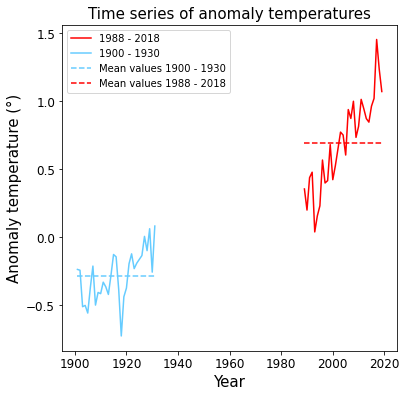

In [27]:
plt.figure(figsize= (6,6))

plt.plot(gmta_last_3_decades['time'], gmta_last_3_decades['gmta'], color = "red", label = "1988 - 2018")
plt.plot(gmta_first_3_decades['time'],gmta_first_3_decades['gmta'], color = "#66ccff", label = "1900 - 1930")

plt.hlines(y = gmta_first_3_decades[colonna].mean(), 
           xmin = gmta_first_3_decades['time'][50], xmax = gmta_first_3_decades['time'][80], 
           linestyles = "--", color = "#66ccff", label = "Mean values 1900 - 1930")

plt.hlines(y = gmta_last_3_decades[colonna].mean(), 
           xmin = gmta_last_3_decades['time'][138], xmax = gmta_last_3_decades['time'][168], 
           linestyles = "--", color = "red", label = "Mean values 1988 - 2018")

plt.xticks(fontsize = 12)
plt.yticks(fontsize = 12)

plt.xlabel("Year", fontsize = 15)
plt.ylabel("Anomaly temperature (°)", fontsize = 15)
plt.title("Time series of anomaly temperatures", fontsize = 15)

plt.legend()